# XAI

In [234]:
import warnings

import dalex as dx
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
import statsmodels.api as sm
import xgboost as xgb
from imodels import RuleFitRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor, plot_tree

In [227]:
sns.set_style("whitegrid")

warnings.filterwarnings("ignore")

# Explainability

Simple models are easy to explain, but they are not always accurate. Complex models are more accurate, but they are not always easy to explain. Explainability is the ability to explain the model's decision in human terms. Explainability is important for many reasons. It helps us to understand the model's decision, to detect bias, to ensure fairness, and to improve the model.

In [228]:
x, y = np.linspace(-1, 1, 1000), np.linspace(0, 2, 1000)
z = 2 + 4 * x + 7 * y + np.random.randn(1000)

In [229]:
fig = px.scatter_3d(x=x, y=y, z=z)
fig.show()

In [230]:
X = np.zeros((len(x), 3))
X[:, :2] = np.vstack((x, y)).T
X[:, 2] = X[:, 0] * X[:, 1]
X = pd.DataFrame(X, columns=['x', 'y', 'xy'])
X.head()

,x,y,xy
0,-1.000000,0.000000,-0.000000
1,-0.997998,0.002002,-0.001998
2,-0.995996,0.004004,-0.003988
3,-0.993994,0.006006,-0.005970
4,-0.991992,0.008008,-0.007944


In [231]:
ols = sm.OLS(z, sm.add_constant(X)).fit()
ols.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.976
Model:                            OLS   Adj. R-squared:                  0.976
Method:                 Least Squares   F-statistic:                 2.046e+04
Date:                Thu, 16 Nov 2023   Prob (F-statistic):               0.00
Time:                        15:04:06   Log-Likelihood:                -1409.1
No. Observations:                1000   AIC:                             2824.
Df Residuals:                     997   BIC:                             2839.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.3346      0.030     77.857      0.000       2.276       2.393
x              4.2688      0.069     61.512      0.000       4.133       4.405
y              6.6034      0.051    129.127      0.000       6.503       6.704
xy             0.1029      0.105      0.980      0.327      -0.103       0.309
==============================================================================
Omnibus:                        1.208   Durbin-Watson:                   2.028
Prob(Omnibus):                  0.547   Jarque-Bera (JB):                1.223
Skew:                           0.023   Prob(JB):                        0.543
Kurtosis:                       2.835   Cond. No.                     2.01e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 6.24e-30. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [232]:
tree = DecisionTreeRegressor(max_depth=2)

tree.fit(X, z)

DecisionTreeRegressor(max_depth=2)

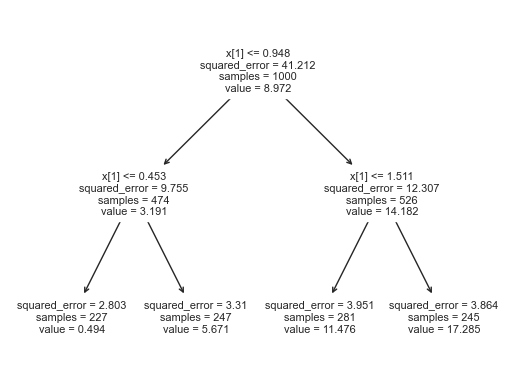

In [233]:
plot_tree(tree)
plt.show()

In [70]:
rulefit = RuleFitRegressor()
rulefit.fit(X, z)

RuleFitRegressor()

## Dalex

### Variable importance

In [202]:
data = dx.datasets.load_apartments()
data.head()

,m2_price,construction_year,surface,floor,no_rooms,district
1,5897,1953,25,3,1,Srodmiescie
2,1818,1992,143,9,5,Bielany
3,3643,1937,56,1,2,Praga
4,3517,1995,93,7,3,Ochota
5,3013,1992,144,6,5,Mokotow


In [345]:
data = pd.get_dummies(data)
X = data.drop(columns='m2_price')
y = data.m2_price

In [346]:
regr = RandomForestRegressor(max_depth=4, random_state=30_08_2000)
regr.fit(X, y)

#we created an explainer with dalex package
exp = dx.Explainer(regr, X, y)

Preparation of a new explainer is initiated

  -> data              : 1000 rows 14 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 1000 values
  -> model_class       : sklearn.ensemble._forest.RandomForestRegressor (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_default at 0x00000239ABF9BD00> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 2.55e+03, mean = 3.48e+03, max = 6.3e+03
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -9.5e+02, mean = 5.29, max = 1.4e+03
  -> model_info        : package sklearn

A new explainer has been created!


In [336]:
rf_importance = pd.DataFrame({'feature': regr.feature_names_in_, 'importance': regr.feature_importances_})
rf_importance = rf_importance.sort_values('importance', ascending=True)
category = pd.CategoricalDtype(categories=rf_importance.feature.values)
rf_importance["feature"] = rf_importance["feature"].astype(category)

In [338]:
px.bar(rf_importance, x='importance', y='feature', 
       orientation='h', title='Random Forest Feature Importance', 
       template="plotly_white")

In [347]:
mp = exp.model_parts(loss_function='rmse', type="difference")
mp

,variable,dropout_loss,label
0,_full_model_,0.000000,RandomForestRegressor
1,district_Bemowo,0.000000,RandomForestRegressor
2,district_Bielany,0.000000,RandomForestRegressor
3,district_Praga,0.000000,RandomForestRegressor
4,district_Ursus,0.000000,RandomForestRegressor
5,district_Wola,0.000000,RandomForestRegressor
6,district_Ursynow,0.097794,RandomForestRegressor
7,no_rooms,3.005510,RandomForestRegressor
8,district_Zoliborz,15.533275,RandomForestRegressor
9,construction_year,22.277277,RandomForestRegressor


In [348]:
mp.plot(max_vars=9)

In [349]:
xgb_regr = xgb.XGBRegressor(max_depth=4, random_state=30_08_2000)

In [350]:
xgb_regr.fit(X, y)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=30082000, ...)

In [351]:
xgb_exp = dx.Explainer(xgb_regr, X, y)

Preparation of a new explainer is initiated

  -> data              : 1000 rows 14 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 1000 values
  -> model_class       : xgboost.sklearn.XGBRegressor (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_default at 0x00000239ABF9BD00> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.62e+03, mean = 3.49e+03, max = 6.57e+03
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.28e+02, mean = -0.014, max = 1.46e+02
  -> model_info        : package xgboost

A new explainer has been created!


In [352]:
exp.model_parts(loss_function='rmse').plot()

There is also `permutation_importance` function in `sklearn.inspection` module.

### Partial dependence profiles

In [325]:
rf_mprofile = exp.model_profile(variables=["surface", "construction_year"] , type="partial")

Calculating ceteris paribus: 100%|██████████| 2/2 [00:00<00:00, 10.78it/s]


In [344]:
# rf_mprofile.plot()
rf_mprofile.plot(geom="profiles")

In [327]:
rf_mprofile_group = exp.model_profile(variables=["surface", "construction_year"],
                                      groups="no_rooms", type="partial")

# plot PDP
rf_mprofile_group.plot()

Calculating ceteris paribus: 100%|██████████| 2/2 [00:00<00:00,  8.90it/s]


In [328]:
lm = LinearRegression()
lm.fit(X,y)

exp_lm = dx.Explainer(lm, X, y)
lm_mprofile = exp_lm.model_profile(variables=["surface", "construction_year"] , type="partial")

# comparison for random forest and linear regression model
rf_mprofile.plot(lm_mprofile)

Preparation of a new explainer is initiated

  -> data              : 1000 rows 14 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 1000 values
  -> model_class       : sklearn.linear_model._base.LinearRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_default at 0x00000239ABF9BD00> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.78e+03, mean = 3.49e+03, max = 6.18e+03
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -2.47e+02, mean = -1.34e-13, max = 4.69e+02
  -> model_info        : package sklearn

A new explainer has been created!


Calculating ceteris paribus: 100%|██████████| 2/2 [00:00<00:00, 69.65it/s]

## Local explanations

In [353]:
apartment = pd.DataFrame({'construction_year'   : [1995],
                          'surface'             : [93],
                          'floor'               : [7],
                          'no_rooms'            : [3],
                          'district_Bemowo'     : [0],
                          'district_Bielany'    : [0],
                          'district_Mokotow'    : [0],
                          'district_Ochota'     : [1],
                          'district_Praga'      : [0],
                          'district_Srodmiescie': [0],
                          'district_Ursus'      : [0],
                          'district_Ursynow'    : [0],
                          'district_Wola'       : [0],
                          'district_Zoliborz'   : [0]},
                          index = ['Apartment'])

### LIME

In [365]:
# rf_pparts = exp.model_surrogate(type="linear") create a surrogate model
rf_pparts = exp.predict_surrogate(new_observation=apartment)

In [366]:
rf_pparts

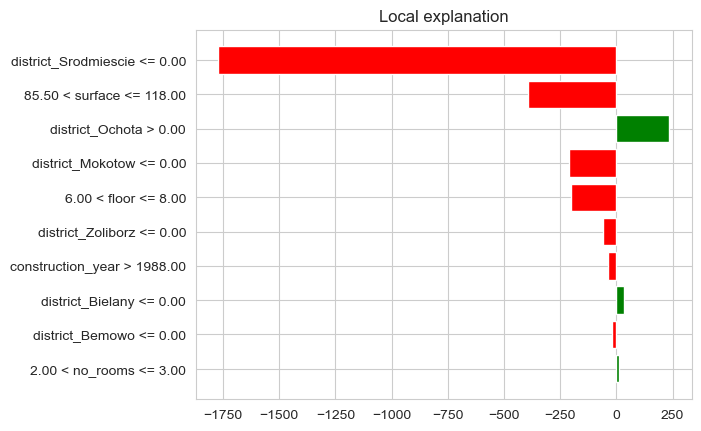

In [360]:
rf_pparts.plot()

### Break down

In [354]:
# Break Down for apartment observation
rf_pparts = exp.predict_parts(new_observation=apartment, type="break_down")

# plot Break Down
rf_pparts.plot(max_vars=15)

### SHAP

In [368]:
apartment = pd.DataFrame({'construction_year'   : [1995],
                          'surface'             : [93],
                          'floor'               : [7],
                          'no_rooms'            : [3],
                          'district_Bemowo'     : [0],
                          'district_Bielany'    : [0],
                          'district_Mokotow'    : [0],
                          'district_Ochota'     : [1],
                          'district_Praga'      : [0],
                          'district_Srodmiescie': [0],
                          'district_Ursus'      : [0],
                          'district_Ursynow'    : [0],
                          'district_Wola'       : [0],
                          'district_Zoliborz'   : [0]},
                          index = ['Apartment'])

# Shapley values for apartment observation
rf_pparts = exp.predict_parts(new_observation = apartment, type = "shap")

# plot Shapley values
rf_pparts.plot()

### Certeris Paribus

In [367]:
rf_profile = exp.predict_profile(new_observation = apartment)

# plot Ceteris Paribus profile
rf_profile.plot(variables = ['construction_year', 'surface', 'floor', 'no_rooms'])

Calculating ceteris paribus: 100%|██████████| 14/14 [00:00<00:00, 60.41it/s]
